# Object Detection with YOLOv3!

This notebook demonstrates how to use YOLOv3 to detect objects in images and videos.

## Import Dependencies

OpenCV, matplotlib, and numpy are the main requirements.

In [1]:
import cv2 as cv
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np

## Define and implement the YOLO class.

In [2]:
class YOLO():
    
    def __init__(self):
        
        """
        - YOLO takes an image as input. We should set the dimension of the image to a fixed number.
        - The default choice is often 416x416.
        - YOLO applies thresholding and non maxima suppression, define a value for both
        - Load the classes, model configuration (cfg file) and pretrained weights (weights file) into variables
        - If the image is 416x416, the weights must be corresponding to that image
        - Load the network with OpenCV.dnn function
        """
        
        # Thresholds for accepting or rejecting detections.
        self.conf_threshold = 0.5
        self.nms_threshold = 0.4
        
        # Input width and height.
        self.inp_width = 416
        self.inp_height = 416
        
        # Class file used by YOLO for classifying detected objects.
        with open("yolov3/coco.names", 'rt') as f:
            
            self.classes = f.read().rstrip('\n').split('\n')
            
        # The model configuration.
        modelConfiguration = "yolov3/yolov3.cfg";
        
        # The weights for the pre-trained model.
        modelWeights = "yolov3/yolov3.weights";
        
        # Create the neural network and specify backend and target.
        self.i = 0
        self.net = cv.dnn.readNetFromDarknet(modelConfiguration, modelWeights)
        self.net.setPreferableBackend(cv.dnn.DNN_BACKEND_OPENCV)
        self.net.setPreferableTarget(cv.dnn.DNN_TARGET_CPU)

In [3]:
def get_output_names(self):
    
    """
    Get the names of the output layers.
    """
    
    # Get the names of all the layers in the network.
    layer_names = self.net.getLayerNames()
    
    # Get the names of the output layers, i.e. the layers with unconnected outputs.
    return [layer_names[i[0] - 1] for i in self.net.getUnconnectedOutLayers()]

YOLO.get_output_names = get_output_names

In [4]:
def draw_pred(self, frame, classId, conf, left, top, right, bottom):
    
    """
    Draw a bounding box around a detected object given the box coordinates.
    """
    
    # Draw the bounding box.
    cv.rectangle(frame, (left, top), (right, bottom), (0, 0, 255), thickness=5)
    label = '%.2f' % conf
    
    # Get the label for the class name and its confidence.
    if self.classes:
        
        assert(classId < len(self.classes))
        label = f"{self.classes[classId]}:{label}"

    # Display the label at the top of the bounding box.
    
    label_size, base_line = cv.getTextSize(label, cv.FONT_HERSHEY_SIMPLEX, 0.5, 1)
    top = max(top, label_size[1])
    cv.putText(frame, label, (left, top), cv.FONT_HERSHEY_SIMPLEX, 1, (255,255,255), thickness=3)
    
    return frame
    
YOLO.draw_pred = draw_pred

In [5]:
def post_process(self, frame, outs):
    
    """
    Take the output out of the neural network and interpret it; use the output to 
    apply NMS thresholding and confidence thresholding. Also use the output to 
    draw the bounding boxes using the draw_pred method.
    """
    
    # Frame width and height.
    frame_height = frame.shape[0]
    frame_width = frame.shape[1]
    class_ids = []
    confidences = []
    boxes = []
    
    # Scan through all the bounding boxes output from the network and keep only the
    # ones with high confidence scores. Assign the box's class label as the class
    # with the highest score.
    class_ids = []
    confidences = []
    boxes = []
    
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > self.conf_threshold:
                center_x = int(detection[0] * frame_width)
                center_y = int(detection[1] * frame_height)
                width = int(detection[2] * frame_width)
                height = int(detection[3] * frame_height)
                left = int(center_x - width / 2)
                top = int(center_y - height / 2)
                class_ids.append(class_id)
                confidences.append(float(confidence))
                boxes.append([left, top, width, height])
                
    # Perform non maximum suppression to eliminate redundant overlapping boxes with
    # lower confidences.
    indices = cv.dnn.NMSBoxes(boxes, confidences, self.conf_threshold, self.nms_threshold)
    
    for i in indices:
        i = i[0]
        box = boxes[i]
        left = box[0]
        top = box[1]
        width = box[2]
        height = box[3]
        output_image = self.draw_pred(frame, class_ids[i], confidences[i], left, top, left + width, top + height)
        
    return output_image

YOLO.post_process = post_process

In [9]:
def inference(self, image):
    
    """
    Main loop taking an image as input and generated frames with drawn
    bounding boxes as output.
    """
    
    # Create a 4D blob from a frame.
    blob = cv.dnn.blobFromImage(image, 1/255, (self.inp_width, self.inp_height), [0,0,0], 1, crop=False)
    
    # Sets the input to the network.
    self.net.setInput(blob)
    
    # Runs the forward pass to get output of the output layers.
    outs = self.net.forward(self.get_output_names())
    
    # Remove the bounding boxes with low confidence
    final_frame = self.post_process(image, outs)
    self.i +=1
    
    return final_frame

YOLO.inference = inference

## Run inference on an image.

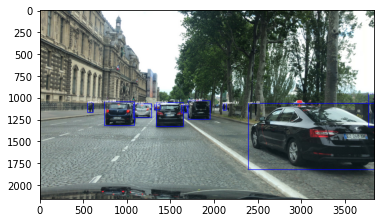

In [10]:
img = mpimg.imread("images/image_0.jpg")
yolo = YOLO()
oi = yolo.inference(img)
plt.imshow(oi)
plt.show()

## Run inference on an video.

A video is just a set of frames, we will call the inference function for each frame of the video and save it.

In [11]:
from moviepy.editor import VideoFileClip
video_file = "videos/1.mp4"
clip = VideoFileClip(video_file).subclip(0,20)
white_clip = clip.fl_image(yolo.inference)
%time white_clip.write_videofile("videos/1-processed.mp4",audio=False)

t:   0%|          | 0/500 [00:00<?, ?it/s, now=None]

Moviepy - Building video videos/1-processed.mp4.
Moviepy - Writing video videos/1-processed.mp4



Moviepy - Done !
Moviepy - video ready videos/1-processed.mp4
CPU times: user 15min 40s, sys: 7.42 s, total: 15min 47s
Wall time: 4min 40s


In [12]:
import io
import base64
from IPython.display import HTML

video = io.open('videos/1-processed.mp4', 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="test" controls width="1280" height="720">
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii'))) 